In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from decode_fish.imports import *
from decode_fish.funcs.file_io import *
from decode_fish.funcs.emitter_io import *
from decode_fish.funcs.utils import *
from decode_fish.funcs.matching import *
from decode_fish.funcs.plotting import *
from torch.utils.data import DataLoader
from decode_fish.funcs.routines import *
import seaborn as sns
from decode_fish.funcs.matching import matching

import h5py

In [3]:
base_dir = '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection'
image_paths = sorted(glob.glob(str(Path(base_dir + '/*p3*.tiff'))))

In [4]:
image_paths[:]

['/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s3l.ome.tiff',
 '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s3r.ome.tiff',
 '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s4l.ome.tiff',
 '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s4r.ome.tiff',
 '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s5l.ome.tiff',
 '/groups/turaga/home/speisera/Mackebox/Artur/WorkDB/deepstorm/datasets/CodFish/raw_data_for_codetection/20170326_dlgYFP_YFPATTO647N_dlg570_p3s5r.ome.tiff']

In [243]:
filename =  'coloc_file_p3_matl_3_bf_no_tx'

with h5py.File(f'../data/results/{filename}.hdf5', 'r') as f:
    print(f['evaluations'].keys())
    
    dec_df_0 = get_df_from_hdf5(f['localizations']['dec_0'])
    dec_df_1 = get_df_from_hdf5(f['localizations']['dec_1'])
    
    fq_df_0 = get_df_from_hdf5(f['localizations']['fq_0'])
    fq_df_1 = get_df_from_hdf5(f['localizations']['fq_1'])
    
    dec_full_pimg = get_df_from_hdf5(f['evaluations']['dec_full_pimg'])
    fq_full_pimg = get_df_from_hdf5(f['evaluations']['fq_full_pimg'])
    
    dec_full_pimg['n_ch0'] = [len(dec_df_0[dec_df_0['frame_idx']==i]) for i in range(len(image_paths))]
    dec_full_pimg['n_ch1'] = [len(dec_df_1[dec_df_1['frame_idx']==i]) for i in range(len(image_paths))]
    fq_full_pimg['n_ch0'] = [len(fq_df_0[fq_df_0['frame_idx']==i]) for i in range(len(image_paths))]
    fq_full_pimg['n_ch1'] = [len(fq_df_1[fq_df_1['frame_idx']==i]) for i in range(len(image_paths))]

<KeysViewHDF5 ['dec_full_pimg', 'fq_full_pimg']>


In [166]:
fq_df_0_ml = fq_df_0
fq_df_1_ml = fq_df_1 

In [168]:
fq_df_0_bf = fq_df_0
fq_df_1_bf = fq_df_1 

In [10]:
# dec_df_0 = dec_df_0[dec_df_0['frame_idx']>2]
# dec_df_1 = dec_df_1[dec_df_1['frame_idx']>2]
# fq_df_0 = fq_df_0[fq_df_0['frame_idx']>2]
# fq_df_1 = fq_df_1[fq_df_1['frame_idx']>2]

In [152]:
dec_full_pimg

,eff_3d,jaccard,n_matches,precision,recall,rmse_vol,rmse_x,rmse_y,rmse_z,n_ch0,n_ch1
0,47.305060,0.759469,3088,0.816499,0.915777,93.770011,44.764708,43.274958,70.115719,3372,3782
1,46.213603,0.797905,3123,0.861517,0.915299,99.690567,42.373376,41.591832,80.080120,3412,3625
2,45.712632,0.725193,2441,0.789968,0.898417,93.636099,41.867930,45.776018,70.138091,2717,3090
3,52.753037,0.824820,2067,0.877707,0.931921,87.758681,44.927914,44.169210,61.091321,2218,2355
4,48.307818,0.795429,2854,0.850164,0.925122,94.943971,45.254864,44.566492,70.570410,3085,3357
5,51.213998,0.812225,1661,0.857955,0.938418,90.055070,43.443209,47.097232,63.280756,1770,1936


In [244]:
#bigfish no tx
fq_full_pimg

,eff_3d,jaccard,n_matches,precision,recall,rmse_vol,rmse_x,rmse_y,rmse_z,n_ch0,n_ch1
0,6.16,0.75,2979,0.84,0.88,181.11,79.84,75.21,144.12,3382,3548
1,5.86,0.78,3001,0.87,0.89,183.24,76.48,74.69,148.82,3390,3441
2,7.32,0.76,2409,0.85,0.88,179.22,74.98,76.45,143.71,2742,2823
3,9.65,0.75,1948,0.85,0.87,173.62,78.36,74.53,135.83,2242,2305
4,3.07,0.75,2725,0.84,0.88,187.24,79.14,78.00,150.70,3105,3260
5,3.90,0.71,1445,0.82,0.84,183.18,81.40,79.33,143.65,1713,1770


In [147]:
#matlab no_tx
fq_full_pimg

,eff_3d,jaccard,n_matches,precision,recall,rmse_vol,rmse_x,rmse_y,rmse_z,n_ch0,n_ch1
0,27.101331,0.647861,2469,0.780341,0.792362,127.658923,57.364450,56.789486,98.899316,3116,3164
1,35.715731,0.741583,2577,0.842983,0.860434,117.722931,51.558791,50.554583,92.976416,2995,3057
2,29.294678,0.661185,2131,0.780586,0.812119,124.117489,52.554052,53.949893,98.654101,2624,2730
3,36.630239,0.771686,1886,0.870328,0.871937,118.227787,51.685181,51.169759,93.210019,2163,2167
4,31.537049,0.742577,2501,0.846935,0.857682,126.878059,53.496933,53.453979,101.876357,2916,2953
5,34.881801,0.771608,1473,0.849481,0.893811,121.963129,52.581969,53.614462,96.102190,1648,1734


In [205]:
perf_df_fq, matches_fq, shift_fq = matching(fq_df_0, fq_df_1, print_res=False)
DF.from_records([perf_df_fq])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.843164,0.824866,0.71514,123.023845,53.36661,53.323856,97.177352,32.21232,13037


In [245]:
perf_df_fq, matches_fq, shift_fq = matching(fq_df_0, fq_df_1, print_res=False)
DF.from_records([perf_df_fq])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.88,0.85,0.76,181.63,78.19,76.17,145.17,5.94,14507


In [209]:
perf_df_dec, matches_dec, shift_dec = matching(dec_df_0, dec_df_1, print_res=False)
DF.from_records([perf_df_dec])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.91915,0.83957,0.781832,94.03503,43.800604,44.143559,70.536799,48.167397,15234


In [252]:
dec_df_1f = filt_perc(dec_df_1, 95)
perf_df_dec, matches_dec, shift_dec = matching(dec_df_0, dec_df_1f, print_res=False)
DF.from_records([perf_df_dec])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.91,0.87,0.80,93.87,44.12,44.36,69.98,49.04,15041


In [264]:
dec_df_1f = filt_perc(dec_df_1, 90)
perf_df_dec, matches_dec, shift_dec = matching(dec_df_0, dec_df_1f, print_res=False)
DF.from_records([perf_df_dec])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.89,0.90,0.81,93.88,44.15,44.73,69.74,49.44,14746


In [214]:
pd.options.display.float_format = '{:,.2f}'.format
perf_all = pd.concat([DF.from_records([perf_df_dec]),DF.from_records([perf_df_fq])]).drop('eff_3d',1)

In [218]:
perf_all.set_axis(['DECODE FISH', 'FISH-quant'], axis=0)

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,n_matches
DECODE FISH,0.92,0.84,0.78,94.04,43.80,44.14,70.54,15234
FISH-quant,0.84,0.82,0.72,123.02,53.37,53.32,97.18,13037


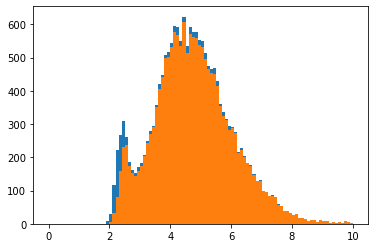

In [263]:
_ = plt.hist(dec_df_1['int'], bins = np.linspace(0,10,101))
_ = plt.hist(dec_df_1f['int'], bins = np.linspace(0,10,101))

In [246]:
ret_matches = DF()
bins_xy = 15000 
bins_z = 20000

dec_perfs = []
fq_perfs = []

cross_ch0_perfs = []
cross_ch1_perfs = []

ds = []
fs = []

for i in range(0,6):
    
    sub_dec = dec_df_0[dec_df_0['frame_idx'] == i].copy()
    
    n_bins_x = int(sub_dec['x'].max()//bins_xy)+1
    n_bins_y = int(sub_dec['y'].max()//bins_xy)+1
    n_bins_z = int(sub_dec['z'].max()//bins_z)+1
    
    print(n_bins_x,n_bins_y,n_bins_z)

    for x in range(n_bins_x):
        for y in range(n_bins_y):
            for z in range(n_bins_z):
                
                sl = np.s_[i:i+1,z*bins_z:(z+1)*bins_z,y*bins_xy:(y+1)*bins_xy,x*bins_xy:(x+1)*bins_xy]
                ds.append(len(crop_df(dec_df_1, sl)))
                fs.append(len(crop_df(fq_df_1, sl)))
                
                dec_perfs.append(matching(crop_df(dec_df_0, sl), crop_df(dec_df_1, sl), print_res=False)[0])
                fq_perfs.append(matching(crop_df(fq_df_0, sl), crop_df(fq_df_1, sl), print_res=False)[0])

                cross_ch0_perfs.append(matching(crop_df(dec_df_0, sl), crop_df(fq_df_0, sl), print_res=False)[0])
                cross_ch1_perfs.append(matching(crop_df(dec_df_1, sl), crop_df(fq_df_1, sl), print_res=False)[0])

5 5 1
5 5 1
5 5 1
5 5 1
5 5 1
5 5 1


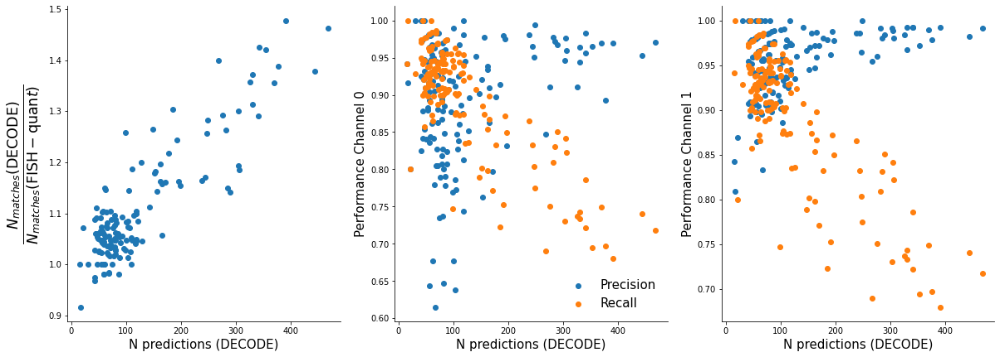

In [241]:
plt.figure(figsize=(20,7))
plt.subplot(131)
plt.scatter(ds, [p['n_matches']/f['n_matches'] for p,f in zip(dec_perfs,fq_perfs)])
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel(r'$\frac{N_{matches} (\mathrm{DECODE})}{N_{matches} (\mathrm{FISH-quan}t)}$', fontsize=25)
sns.despine()

plt.subplot(132)
plt.scatter(ds, [p['precision'] for p in cross_ch0_perfs], label='Precision')
plt.scatter(ds, [p['recall'] for p in cross_ch0_perfs], label='Recall')
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel('Performance Channel 0', fontsize=15)
plt.legend(frameon=False, loc='lower right', fontsize=15)
sns.despine()

plt.subplot(133)
plt.scatter(ds, [p['precision'] for p in cross_ch1_perfs])
plt.scatter(ds, [p['recall'] for p in cross_ch0_perfs])
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel('Performance Channel 1', fontsize=15)
sns.despine()

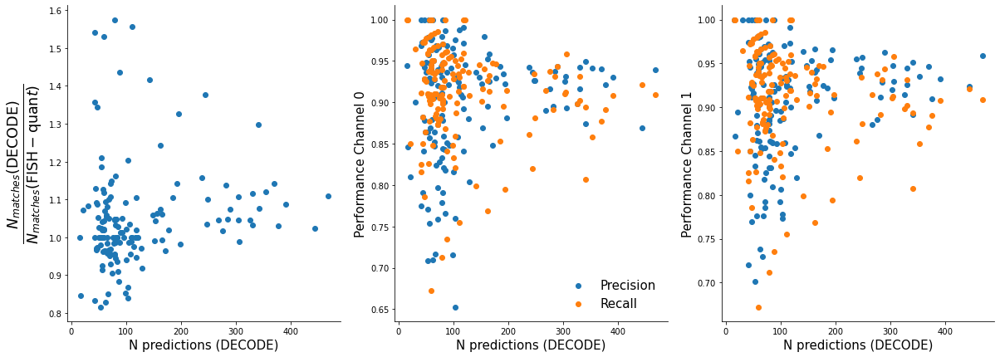

In [247]:
plt.figure(figsize=(20,7))
plt.subplot(131)
plt.scatter(ds, [p['n_matches']/f['n_matches'] for p,f in zip(dec_perfs,fq_perfs)])
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel(r'$\frac{N_{matches} (\mathrm{DECODE})}{N_{matches} (\mathrm{FISH-quan}t)}$', fontsize=25)
sns.despine()

plt.subplot(132)
plt.scatter(ds, [p['precision'] for p in cross_ch0_perfs], label='Precision')
plt.scatter(ds, [p['recall'] for p in cross_ch0_perfs], label='Recall')
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel('Performance Channel 0', fontsize=15)
plt.legend(frameon=False, loc='lower right', fontsize=15)
sns.despine()

plt.subplot(133)
plt.scatter(ds, [p['precision'] for p in cross_ch1_perfs])
plt.scatter(ds, [p['recall'] for p in cross_ch0_perfs])
plt.xlabel('N predictions (DECODE)', fontsize=15)
plt.ylabel('Performance Channel 1', fontsize=15)
sns.despine()

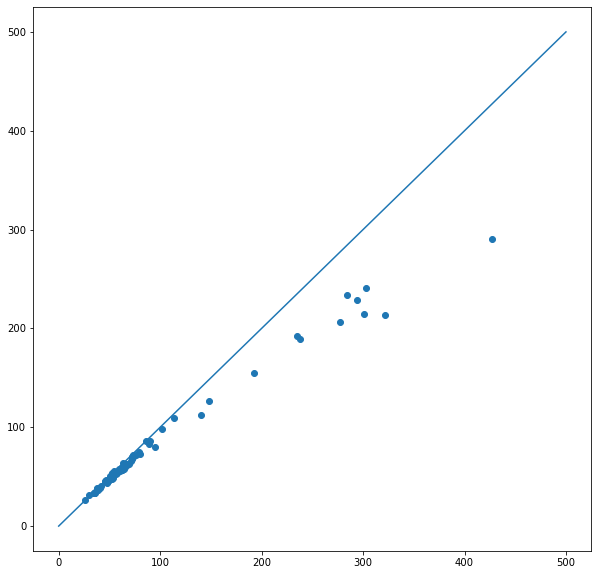

In [423]:
plt.figure(figsize=(10,10))
plt.scatter([p['n_matches'] for p in dec_perfs],[p['n_matches'] for p in fq_perfs])
plt.plot([0,500],[0,500])

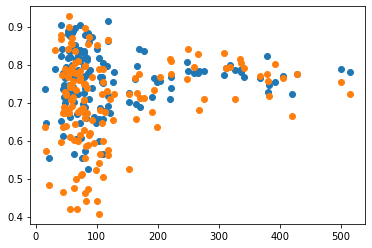

In [393]:
plt.scatter(ns, [p['jaccard'] for p in dec_perfs])
plt.scatter(ns, [p['jaccard'] for p in fq_perfs])

In [361]:
sl = np.s_[i:,z*bins_z:(z+1)*bins_z,y*bins_xy:(y+1)*bins_xy,x*bins_xy:(x+1)*bins_xy]

In [349]:
sl

(slice(5, 6, None),
 slice(6000, 8000, None),
 slice(60000, 80000, None),
 slice(60000, 80000, None))

In [257]:
def get_rmse(match_df):
    rmses = (match_df['x_tar'] - match_df['x_pred'])**2 
    rmses += (match_df['y_tar'] - match_df['y_pred'])**2
    rmses += (match_df['z_tar'] - match_df['z_pred'])**2

    return np.sqrt(rmses.mean())

In [328]:
ret_matches = DF()

for i in [3,4,5]:
    
    sub_matches = matches_dec[matches_dec['frame_idx'] == i].copy()
    
    for k in ['x','y','z']:
        for l in ['z','y','x']:

            bins = 10000 if l in 'xy' else 1000

            error = sub_matches[k+'_tar'] - sub_matches[k+'_pred']
            pos = sub_matches[l+'_tar']

            for i in range(int(pos.max()//bins + 1)):
                inds = (pos > i*bins).mul(pos < (i+1)*bins)
                shift = error[inds].mean()

                sub_matches.loc[inds,k+'_pred'] += shift
                
    ret_matches = pd.concat([ret_matches, sub_matches], axis=0)

In [329]:
get_rmse(ret_matches)

92.23508109302344

In [325]:
ret_matches = DF()
bins_xy = 20000 
bins_z = 2000

for i in [3,4,5]:
    
    sub_matches = matches_dec[matches_dec['frame_idx'] == i].copy()
    
    n_bins_x = int(sub_matches['x_tar'].max()//bins_xy)+1
    n_bins_y = int(sub_matches['y_tar'].max()//bins_xy)+1
    n_bins_z = int(sub_matches['z_tar'].max()//bins_z)+1
    
    print(n_bins_x*n_bins_y*n_bins_z)

    for x in range(n_bins_x):
        for y in range(n_bins_y):
            for z in range(n_bins_z):
                
                subm = crop_df(sub_matches, np.s_[:,z*bins_z:(z+1)*bins_z,y*bins_xy:(y+1)*bins_xy,x*bins_xy:(x+1)*bins_xy], keys=['frame_idx','z_tar','y_tar','x_tar'])
                if len(subm):
                    for k in ['x','y','z']:
                        error = subm[k+'_tar'] - subm[k+'_pred']
                        shift = error.mean()
                        subm.loc[:,k+'_pred'] += shift
                
                ret_matches = pd.concat([ret_matches, subm], axis=0)

In [326]:
get_rmse(ret_matches)

91.18526931318142

In [249]:
def get_match_rmses(match_df):
    rmses = (match_df['x_tar'] - match_df['x_pred'])**2 
    rmses += (match_df['y_tar'] - match_df['y_pred'])**2
    rmses += (match_df['z_tar'] - match_df['z_pred'])**2
    return np.sqrt(rmses)

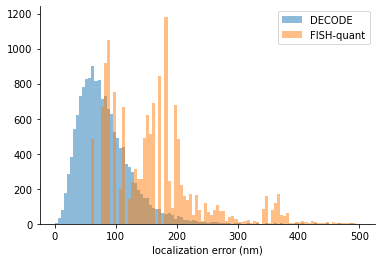

In [250]:
_ = plt.hist(get_match_rmses(matches_dec), bins = np.linspace(0,500,101), alpha=0.5, label='DECODE')
_ = plt.hist(get_match_rmses(matches_fq), bins = np.linspace(0,500,101), alpha=0.5, label='FISH-quant')
plt.legend()
plt.xlabel('localization error (nm)')
sns.despine()

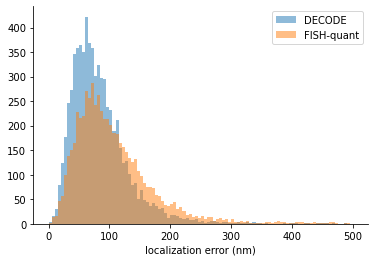

In [75]:
_ = plt.hist(get_match_rmses(matches_dec), bins = np.linspace(0,500,101), alpha=0.5, label='DECODE')
_ = plt.hist(get_match_rmses(matches_fq), bins = np.linspace(0,500,101), alpha=0.5, label='FISH-quant')
plt.legend()
plt.xlabel('localization error (nm)')
sns.despine()

In [332]:
dec_df_0['loc_idx'] = np.arange(len(dec_df_0))
fq_df_0['loc_idx'] = np.arange(len(fq_df_0))

perf_cross, matches_cross, shift = matching(dec_df_0, fq_df_0, print_res=True)

Recall: 0.834
Precision: 0.935
Jaccard: 78.824
RMSE_vol: 182.118
Eff_3d: 6.511
FN: 1271.0 FP: 447.0
Num. matches: 6395.000
Shift: 69.07,71.90,106.84


In [340]:
dec_sub_0 = dec_df_0.iloc[list(matches_cross['tar_idx'].values)]

In [341]:
    len(dec_sub_0)

6395

In [113]:
dec_sub_0 = dec_df_0.iloc[list(matches_cross['tar_idx'].values)]
fq_sub_0 = fq_df_0.iloc[list(matches_cross['pred_idx'].values)]

In [111]:
perf_df_fq, matches_fq, shift_fq = matching(fq_sub_0, fq_df_1, print_res=False)
DF.from_records([perf_df_fq])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.923378,0.846716,0.791131,122.666528,53.084237,52.944868,97.087495,35.207771,5905


In [114]:
perf_df_dec, matches_dec, shift_dec = matching(dec_sub_0, dec_df_1, print_res=False)
DF.from_records([perf_df_dec])

,recall,precision,jaccard,rmse_vol,rmse_x,rmse_y,rmse_z,eff_3d,n_matches
0,0.948866,0.759639,0.729765,93.829553,46.780349,46.726677,66.574782,45.858858,6068


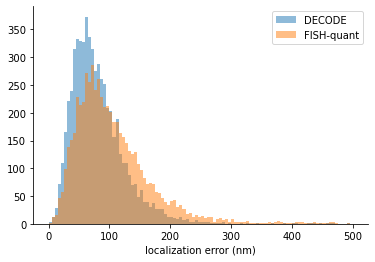

In [115]:
_ = plt.hist(get_match_rmses(matches_dec), bins = np.linspace(0,500,101), alpha=0.5, label='DECODE')
_ = plt.hist(get_match_rmses(matches_fq), bins = np.linspace(0,500,101), alpha=0.5, label='FISH-quant')
plt.legend()
plt.xlabel('localization error (nm)')
sns.despine()

0.5010551889354259


(0.0, 30000.0)

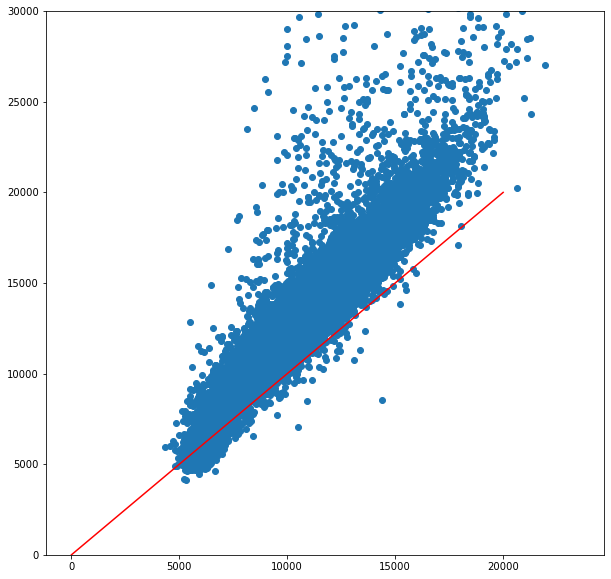

In [122]:
plt.figure(figsize=(10,10))
plt.scatter(matches['int_tar']*2000, matches['int_pred'])
print(np.corrcoef(matches['int_tar'], matches['int_pred'])[0,1])
plt.plot([0,20000],[0,20000], color='red')
plt.ylim(0,30000)

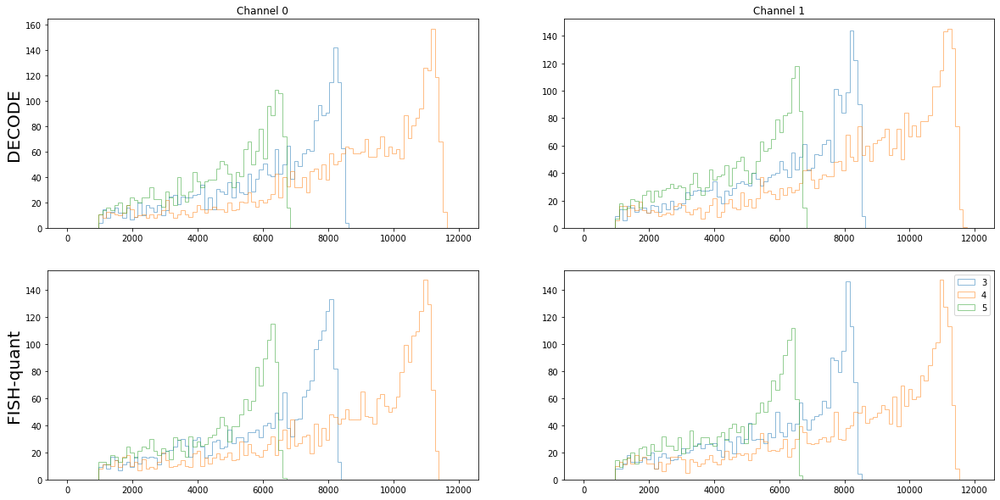

In [151]:
plt.figure(figsize=(20,10))

for i in range(3,6):
    
    dec_0_sub = dec_df_0[dec_df_0['frame_idx']==i]
    dec_1_sub = dec_df_1[dec_df_1['frame_idx']==i]

    fq_0_sub = fq_df_0[fq_df_0['frame_idx']==i]
    fq_1_sub = fq_df_1[fq_df_1['frame_idx']==i]

    plt.subplot(221)
    _=plt.hist(dec_0_sub['z'], alpha=0.5, bins=np.linspace(0,12000,101), histtype='step', density=False)

    plt.ylabel('DECODE', fontsize=20)
    plt.title('Channel 0')
    
    plt.subplot(222)
    _=plt.hist(dec_1_sub['z'], alpha=0.5, bins=np.linspace(0,12000,101), histtype='step', density=False)
    
    plt.title('Channel 1')
    
    plt.subplot(223)
    _=plt.hist(fq_0_sub['z'], alpha=0.5, bins=np.linspace(0,12000,101), histtype='step', density=False)
    
    plt.ylabel('FISH-quant', fontsize=20)

    plt.subplot(224)
    _=plt.hist(fq_1_sub['z'], alpha=0.5, bins=np.linspace(0,12000,101), histtype='step', density=False, label = i)
    
plt.legend()

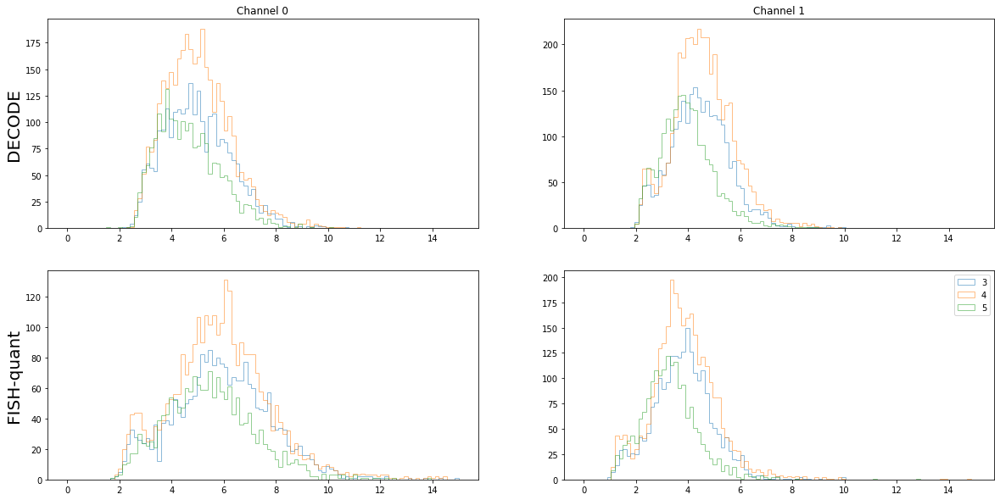

In [120]:
plt.figure(figsize=(20,10))

for i in range(3, 6):
    
    dec_0_sub = dec_0_df[dec_0_df['frame_idx']==i]
    dec_1_sub = dec_1_df[dec_1_df['frame_idx']==i]

    fq_0_sub = fq_0_df[fq_0_df['frame_idx']==i]
    fq_1_sub = fq_1_df[fq_1_df['frame_idx']==i]

    plt.subplot(221)
    _=plt.hist(dec_0_sub['int'], alpha=0.5, bins=np.linspace(0,15,101), histtype='step', density=False)

    plt.ylabel('DECODE', fontsize=20)
    plt.title('Channel 0')
    
    plt.subplot(222)
    _=plt.hist(dec_1_sub['int'], alpha=0.5, bins=np.linspace(0,15,101), histtype='step', density=False)
    
    plt.title('Channel 1')
    
    plt.subplot(223)
    _=plt.hist(fq_0_sub['int']/2000, alpha=0.5, bins=np.linspace(0,15,101), histtype='step', density=False)
    
    plt.ylabel('FISH-quant', fontsize=20)

    plt.subplot(224)
    _=plt.hist(fq_1_sub['int']/2000, alpha=0.5, bins=np.linspace(0,15,101), histtype='step', density=False, label = i)
    
plt.legend()
    

In [ ]:
for i in range(6):
    sub_0 = dec_0_df[dec_0_df['frame_idx']==i]
    sub_1 = dec_1_df[dec_1_df['frame_idx']==i]
    
    perf_df, matches, shift = matching(sub_0, sub_1, print_res=True)

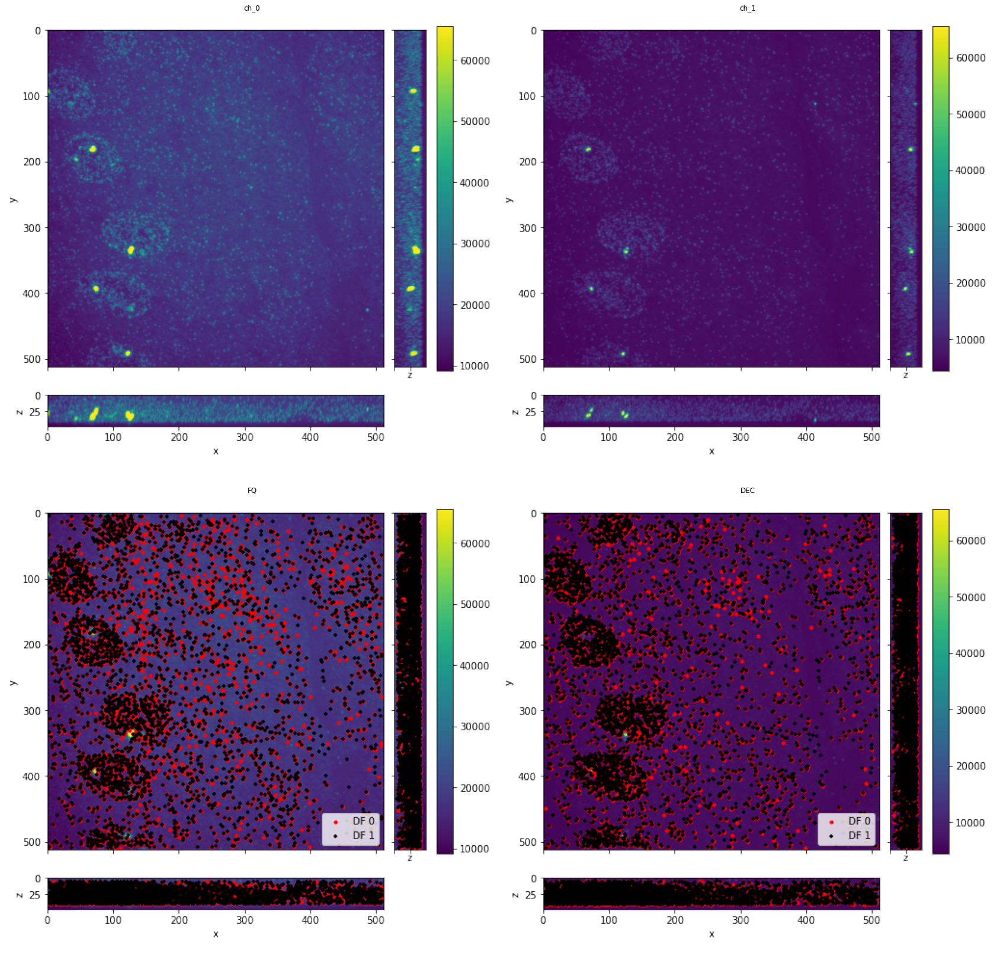

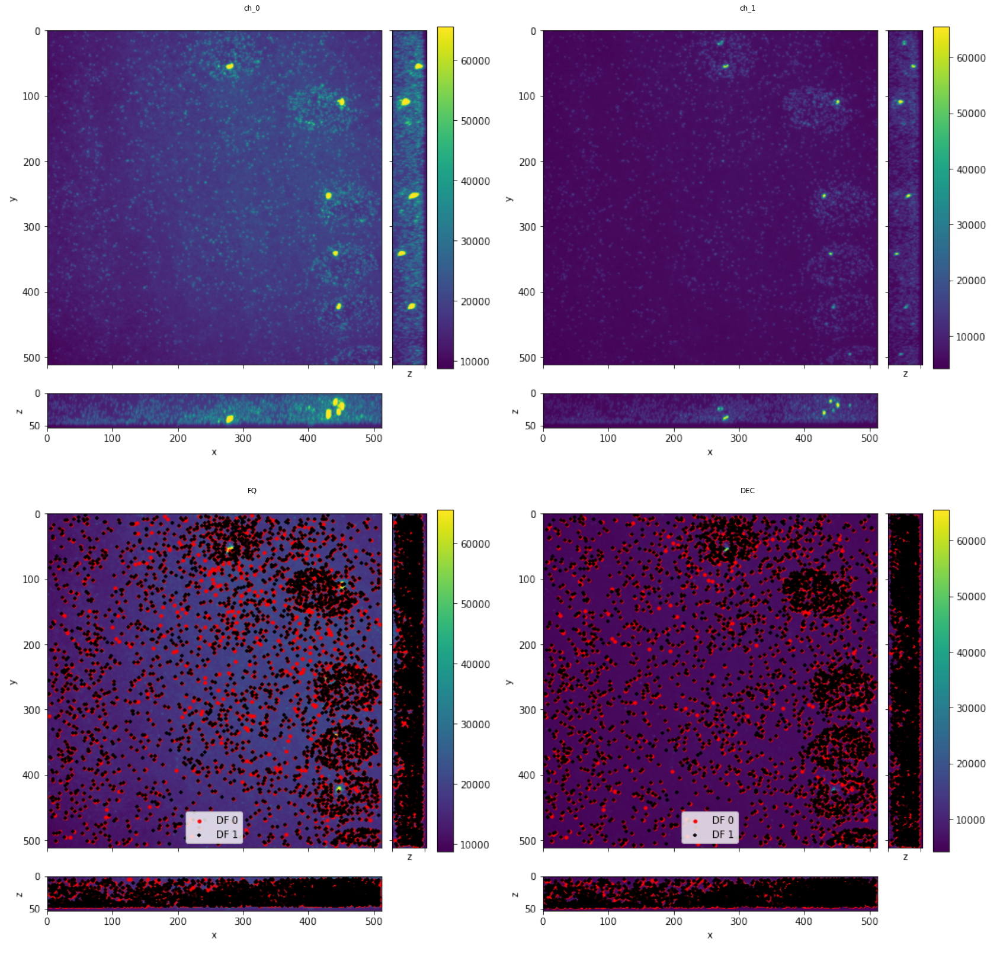

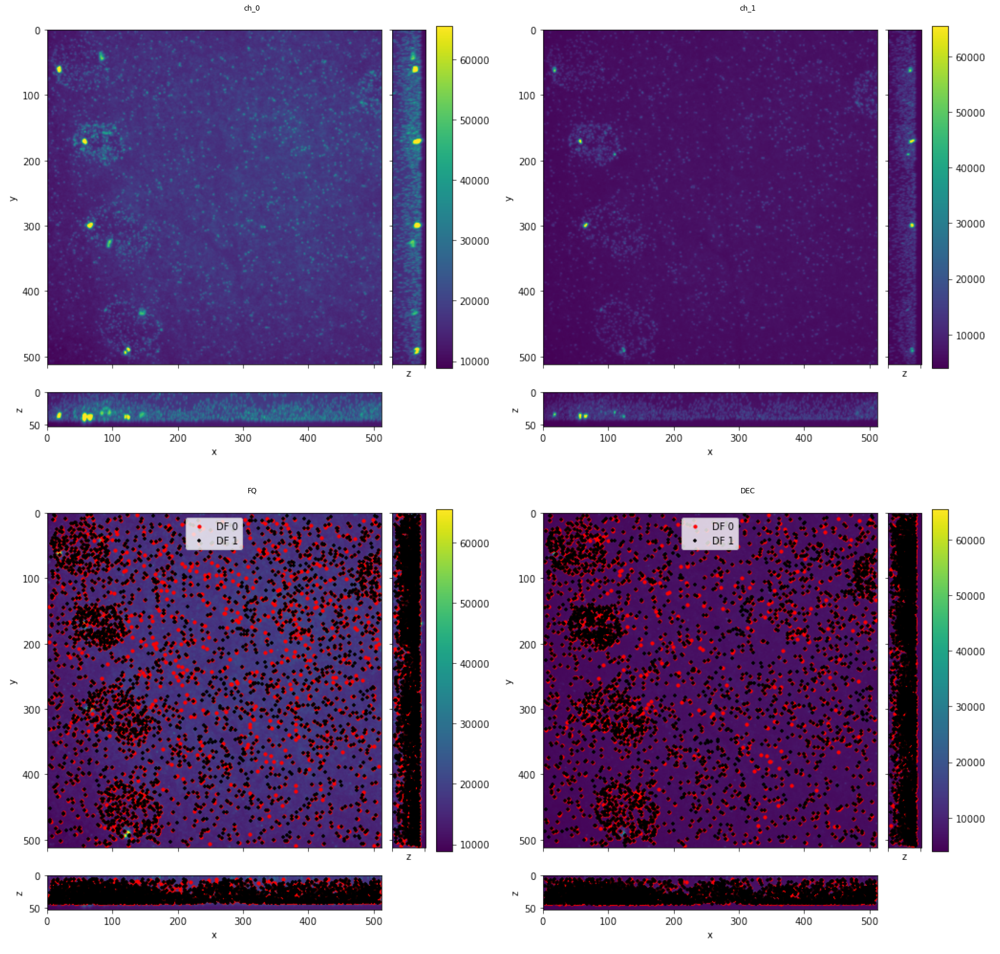

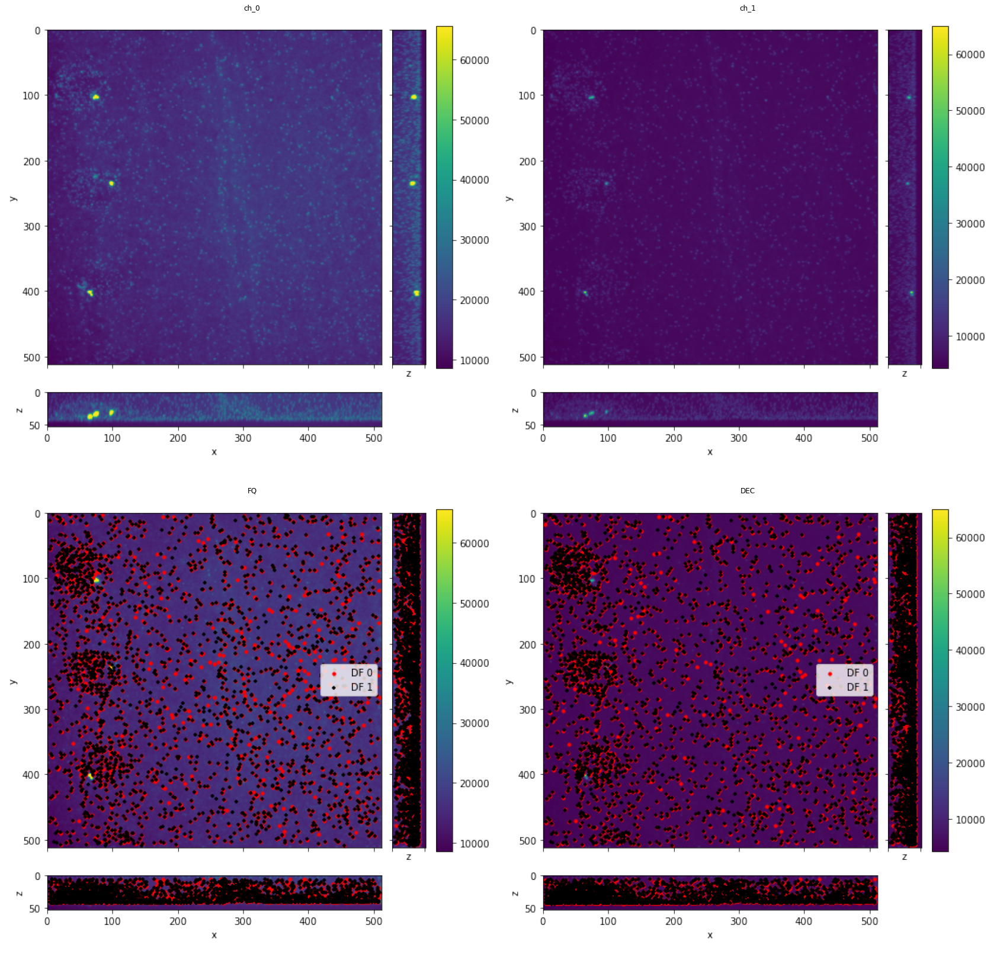

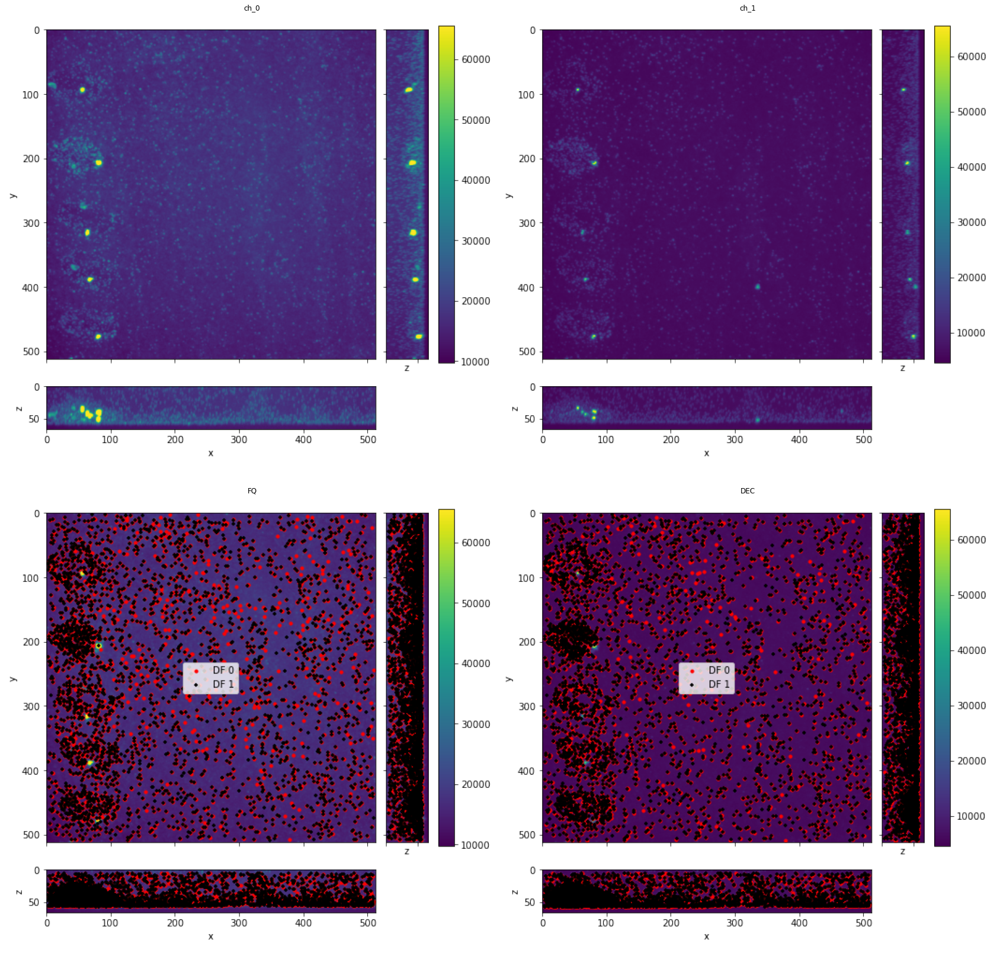

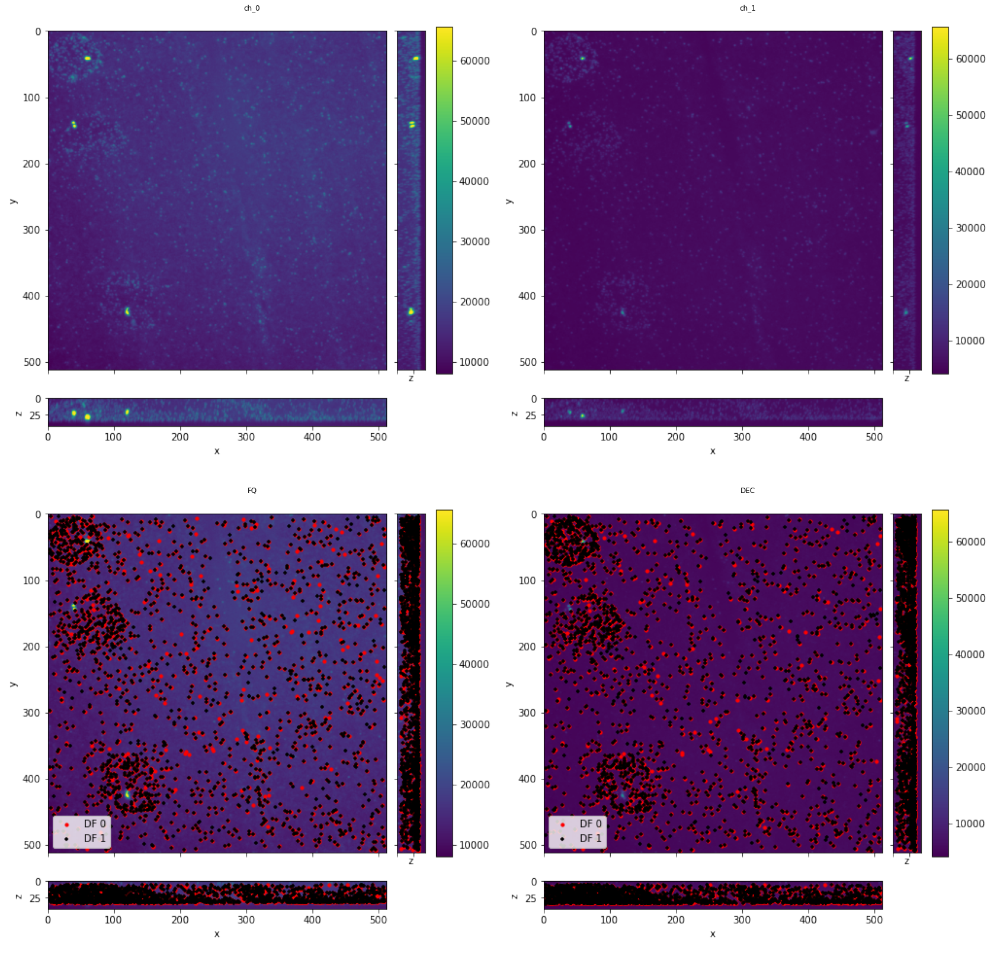

In [131]:
# sl = np.s_[:,:,0:200,0:200]
sl = np.s_[:,:,:,:]

for i in range(0, 6):
    
    img = load_tiff_image(image_paths[i])[sl]
    fig1,_ = plot_3d_projections(img[0], display=False)
    fig2,_ = plot_3d_projections(img[1], display=False)
    fig3,axes = plot_3d_projections(img[0], display=False)
    
    fq0 = crop_df(nm_to_px(fq_df_0[fq_df_0['frame_idx']==i], px_size_zyx=[200,139,139]),sl)
    fq1 = crop_df(nm_to_px(fq_df_1[fq_df_1['frame_idx']==i], px_size_zyx=[200,139,139]),sl)
    
    dec0 = crop_df(nm_to_px(dec_df_0[dec_df_0['frame_idx']==i], px_size_zyx=[200,139,139]),sl)
    dec1 = crop_df(nm_to_px(dec_df_1[dec_df_1['frame_idx']==i], px_size_zyx=[200,139,139]),sl)    
    
    scat_3d_projections(axes, [fq0, fq1])
    fig4,axes = plot_3d_projections(img[1], display=False)
    scat_3d_projections(axes, [dec0, dec1])
    _ =combine_figures([fig1,fig2,fig3, fig4],['ch_0','ch_1','FQ','DEC'], figsize=(30,30), ncols=2, nrows=2)
    plt.show()

In [40]:
def get_match_rmses(match_df):
    rmses = (match_df['x_tar'] - match_df['x_pred'])**2 
    rmses += (match_df['y_tar'] - match_df['y_pred'])**2
    rmses += (match_df['z_tar'] - match_df['z_pred'])**2
    rmses /= 3
    return np.sqrt(rmses)

In [132]:
from decode_fish.funcs.fit_psf import *
import matplotlib.patches as patches

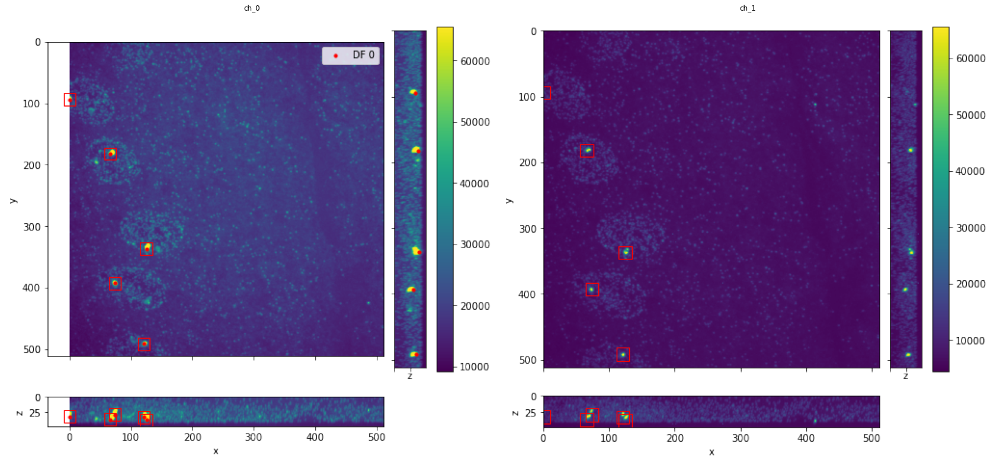

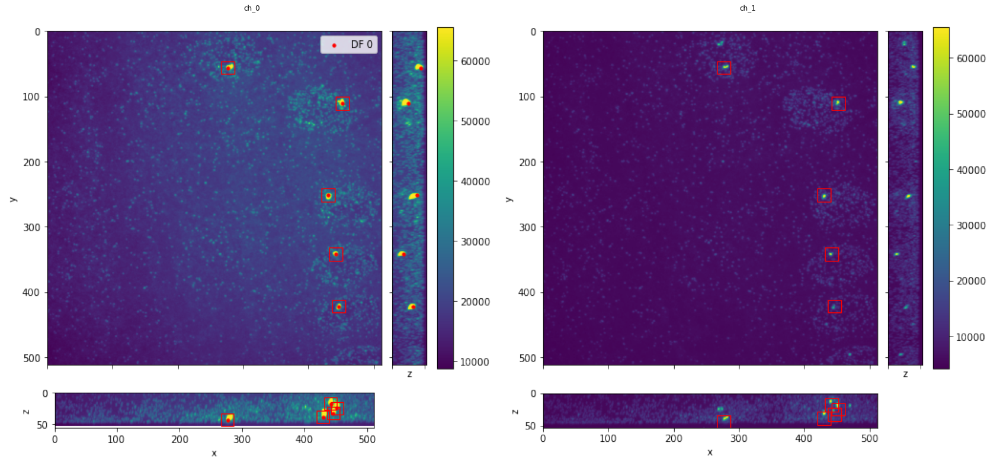

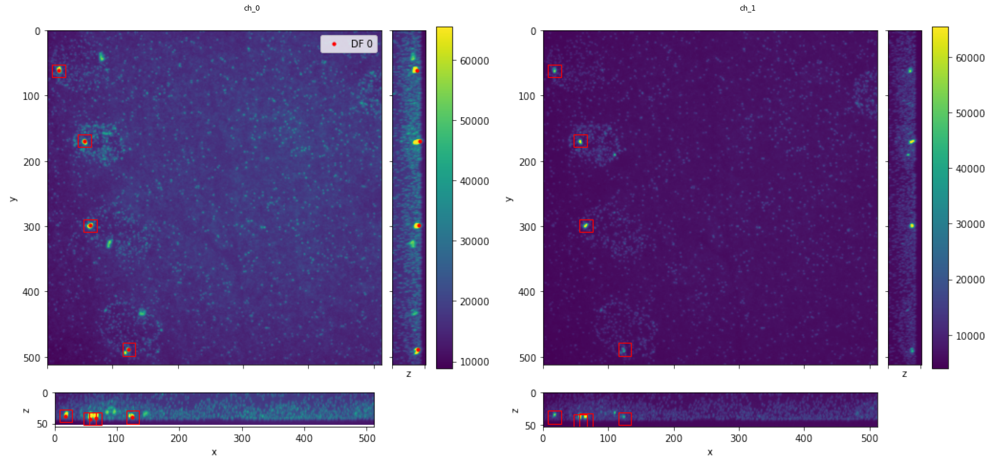

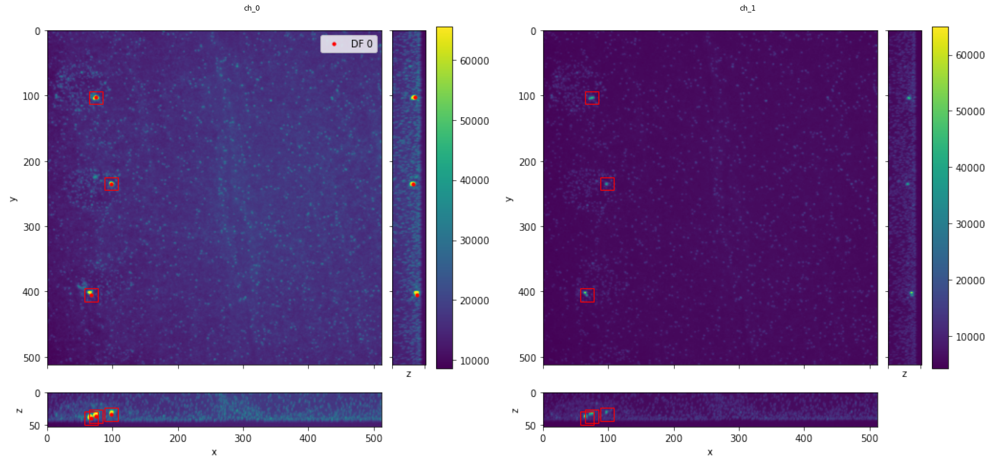

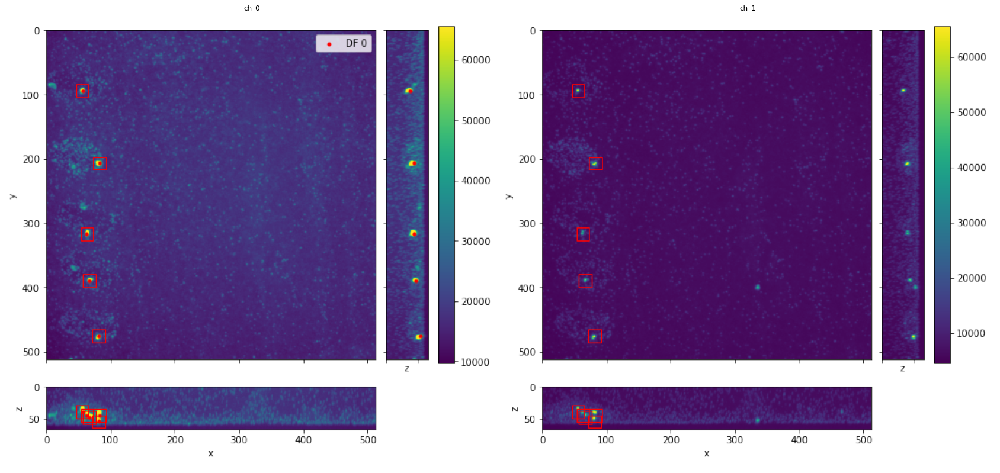

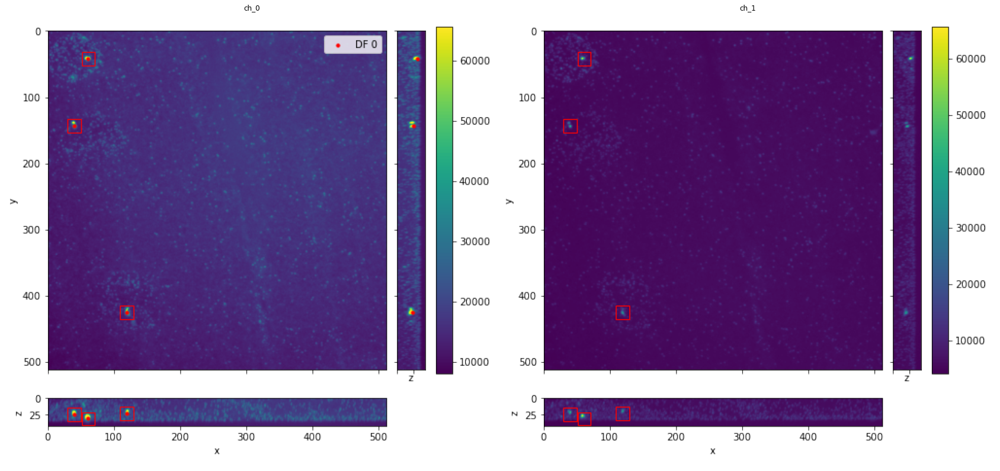

In [133]:
th_ch0 = 62000
px_size_zyx = [200,139,139]
# th_ch1 = 40000

tx_size = [10,10,10]
peak_df = DF()

for i,f in enumerate(image_paths):
    img = load_tiff_image(f)
    
    img_ch0 = img[0]
    peaks_ch0 = get_peaks_3d(img_ch0, threshold=th_ch0, min_distance=20)
    peaks_ch0['frame_idx'] = i
    peak_df = pd.concat([peak_df, peaks_ch0])
    
    img_ch1 = img[1]
    
    fig0,axes0 = plot_3d_projections(img_ch0, display=False)
    scat_3d_projections(axes0, [peaks_ch0])
    
    fig1,axes1 = plot_3d_projections(img_ch1, display=False)
    
    for k in range(len(peaks_ch0)):
        rect_xy = patches.Rectangle((peaks_ch0.iloc[k]['x']-tx_size[2], peaks_ch0.iloc[k]['y']-tx_size[1]), 2*tx_size[2], 2*tx_size[1], linewidth=1, edgecolor='r', facecolor='none')
        axes0[0].add_patch(rect_xy)
        rect_xz = patches.Rectangle((peaks_ch0.iloc[k]['x']-tx_size[2], peaks_ch0.iloc[k]['z']-tx_size[0]), 2*tx_size[2], 2*tx_size[0], linewidth=1, edgecolor='r', facecolor='none')
        axes0[1].add_patch(rect_xz)
        
    for k in range(len(peaks_ch0)):
        rect_xy = patches.Rectangle((peaks_ch0.iloc[k]['x']-tx_size[2], peaks_ch0.iloc[k]['y']-tx_size[1]), 2*tx_size[2], 2*tx_size[1], linewidth=1, edgecolor='r', facecolor='none')
        axes1[0].add_patch(rect_xy)
        rect_xz = patches.Rectangle((peaks_ch0.iloc[k]['x']-tx_size[2], peaks_ch0.iloc[k]['z']-tx_size[0]), 2*tx_size[2], 2*tx_size[0], linewidth=1, edgecolor='r', facecolor='none')
        axes1[1].add_patch(rect_xz)
    
    _ =combine_figures([fig0,fig1],['ch_0','ch_1'], figsize=(30,15), ncols=2, nrows=1)
    plt.show()

In [134]:
filename =  'coloc_file_p3_matl_3'

with h5py.File(f'../data/results/{filename}.hdf5', 'r') as f:
    print(f['evaluations'].keys())
    
    dec_df_0 = get_df_from_hdf5(f['localizations']['dec_0'])
    dec_df_1 = get_df_from_hdf5(f['localizations']['dec_1'])
    
    fq_df_0 = get_df_from_hdf5(f['localizations']['fq_0'])
    fq_df_1 = get_df_from_hdf5(f['localizations']['fq_1'])
    
    dec_full_pimg = get_df_from_hdf5(f['evaluations']['dec_full_pimg'])
    fq_full_pimg = get_df_from_hdf5(f['evaluations']['fq_full_pimg'])
    
    dec_full_pimg['n_ch0'] = [len(dec_df_0[dec_df_0['frame_idx']==i]) for i in range(len(image_paths))]
    dec_full_pimg['n_ch1'] = [len(dec_df_1[dec_df_1['frame_idx']==i]) for i in range(len(image_paths))]
    fq_full_pimg['n_ch0'] = [len(fq_df_0[fq_df_0['frame_idx']==i]) for i in range(len(image_paths))]
    fq_full_pimg['n_ch1'] = [len(fq_df_1[fq_df_1['frame_idx']==i]) for i in range(len(image_paths))]

<KeysViewHDF5 ['dec_full_pimg', 'fq_full_pimg']>


In [135]:
tx_size = [10,10,10]

slices = []

for p in peak_df.iterrows():
    p=p[1]
    slices.append(np.s_[p['frame_idx']:p['frame_idx']+1, p['z']-tx_size[0]:p['z']+tx_size[0], p['y']-tx_size[1]:p['y']+tx_size[1], p['x']-tx_size[2]:p['x']+tx_size[2]])

In [138]:
cfg = OmegaConf.load('../config/coloc_eval_p3.yaml')

In [143]:
[1] + list(cfg.filt_tx.px_size_zyx)

[1, 200, 139, 139]

In [144]:
dec_0_crops = pd.concat([crop_df(dec_df_0, s, px_size_zyx=cfg.filt_tx.px_size_zyx, shift=False) for s in slices])
dec_df_0 = pd.concat([dec_df_0, dec_0_crops]).drop_duplicates(keep=False)

dec_1_crops = pd.concat([crop_df(dec_df_1, s, px_size_zyx=px_size_zyx, shift=False) for s in slices])
dec_df_1 = pd.concat([dec_df_1, dec_1_crops]).drop_duplicates(keep=False)

fq_0_crops = pd.concat([crop_df(fq_df_0, s, px_size_zyx=px_size_zyx, shift=False) for s in slices])
fq_df_0 = pd.concat([fq_df_0, fq_0_crops]).drop_duplicates(keep=False)

fq_1_crops = pd.concat([crop_df(fq_df_1, s, px_size_zyx=px_size_zyx, shift=False) for s in slices])
fq_df_1 = pd.concat([fq_df_1, fq_1_crops]).drop_duplicates(keep=False)

In [137]:
print(len(dec_df_0), len(dec_df_0_f))
print(len(fq_df_0), len(fq_df_0_f))

print(len(dec_df_1), len(dec_df_1_f))
print(len(fq_df_1), len(fq_df_1_f))

16574 16574
15462 15462
18145 18145
15805 15805


In [199]:
def scat_3d_projections(axes, dfs, px_size_zyx=[1.,1.,1], s_fac=1., labels=None):
    colors = ['red','black','orange']
    markers = ['o','o','x']
    if labels is None:
        labels=[f'DF {i}' for i in range(3)]
    
    if not isinstance(dfs, list):
        dfs = [dfs]
    for i,df in enumerate(dfs):
        df = nm_to_px(df, px_size_zyx)
        axes[0].scatter(df['x'],df['y'], color=colors[i], marker=markers[i], s=10*s_fac, label=labels[i])
        axes[1].scatter(df['x'],df['z'], color=colors[i], marker=markers[i], s=10*s_fac)
        axes[2].scatter(df['z'],df['y'], color=colors[i], marker=markers[i], s=10*s_fac)
    axes[0].legend()

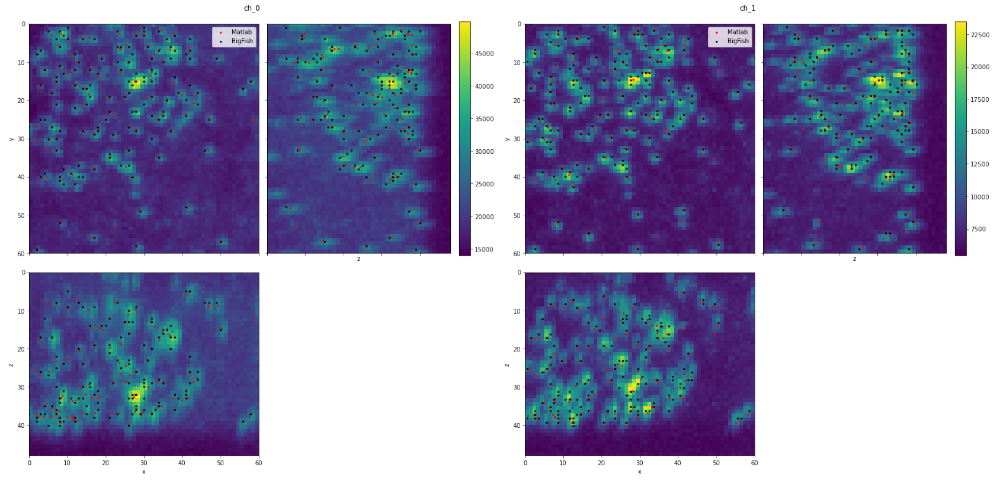

In [200]:
sl = np.s_[:,:,190:250,70:130]
ind = 0 
# sl = np.s_[:,:,:,:]

img = load_tiff_image(image_paths[ind])[sl]
# fig1,_ = plot_3d_projections(img[0], display=False)
# fig2,_ = plot_3d_projections(img[1], display=False)
fig3,axes = plot_3d_projections(img[0], display=False)

fq0_ml = crop_df(nm_to_px(fq_df_0_ml[fq_df_0_ml['frame_idx']==ind], px_size_zyx=[200,139,139]),sl)
fq1_ml = crop_df(nm_to_px(fq_df_1_ml[fq_df_1_ml['frame_idx']==ind], px_size_zyx=[200,139,139]),sl)

fq0_bf = crop_df(nm_to_px(fq_df_0_bf[fq_df_0_bf['frame_idx']==ind], px_size_zyx=[200,139,139]),sl)
fq1_bf = crop_df(nm_to_px(fq_df_1_bf[fq_df_1_bf['frame_idx']==ind], px_size_zyx=[200,139,139]),sl)

scat_3d_projections(axes, [fq0_ml, fq0_bf], s_fac=0.5, labels=['Matlab','BigFish'])
fig4,axes = plot_3d_projections(img[1], display=False)
scat_3d_projections(axes, [fq1_ml, fq1_bf], s_fac=0.5, labels=['Matlab','BigFish'])
_ =combine_figures([fig3,fig4],['ch_0','ch_1'], figsize=(30,30), ncols=2, nrows=1)

plt.show()

In [186]:
print('ML', len(fq0_ml), len(fq1_ml))
_, _, _ = matching(px_to_nm(fq0_ml, px_size_zyx=[200,139,139]), px_to_nm(fq1_ml, px_size_zyx=[200,139,139]), print_res=True)
print('BF', len(fq0_bf), len(fq1_bf))
_, _, _ = matching(px_to_nm(fq0_bf, px_size_zyx=[200,139,139]), px_to_nm(fq1_bf, px_size_zyx=[200,139,139]), print_res=True)

ML 128 127
Recall: 0.836
Precision: 0.843
Jaccard: 72.297
RMSE_vol: 131.857
Eff_3d: 28.488
FN: 21.0 FP: 20.0
Num. matches: 107.000
Shift: 2.81,-7.40,31.11
BF 152 163
Recall: 0.882
Precision: 0.822
Jaccard: 74.033
RMSE_vol: 180.885
Eff_3d: 5.904
FN: 18.0 FP: 29.0
Num. matches: 134.000
Shift: -5.28,-5.01,51.29


In [ ]:
Sparse high-dimensional model of neural activity
facilitates flexible state estimation